In [1]:
using Plots, ColorSchemes, Statistics
Plots.default(fontfamily="Computer Modern")
include("src/HPMC.jl")

Main.HPMC

In [10]:
function plotdoubledisk(r, d, p)
    filepath = "data/raw/4gon$(r)r$(d)d$(p)p1.jld2"
    particles = HPMC.RegularPolygons(
        HPMC.RegularPolygonsSnapshot(filepath, HPMC.framecount(filepath)), gpu=true)
    p = plot(particles, abs.(HPMC.katic_order(particles, 4)))
    θs = collect(0:0.01:2π)
    plot!(p, r * cos.(θs) .+ (r + d / 2), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)
    plot!(p, r * cos.(θs) .- (r + d / 2), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)
    return p
end

plotdoubledisk (generic function with 2 methods)

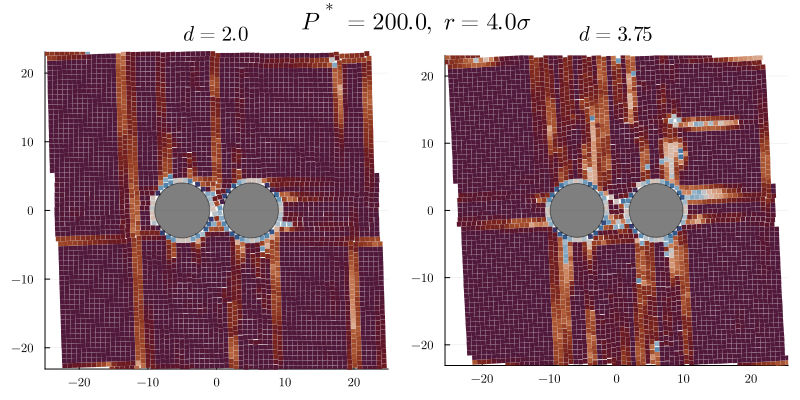

In [13]:
p1 = plotdoubledisk(4.0, 2.0, 200.0)
plot!(p1, title="\$d=2.0\$")
p2 = plotdoubledisk(4.0, 3.75, 200.0)
plot!(p2, title="\$d=3.75\$")

p = plot(p1, p2, layout=(1, 2), plot_title="\$P^*=200.0,\\ r=4.0\\sigma\$", size=(800, 400))
savefig(p, "../fig/doubledisk_200.0p_2.0d_3.75d.pdf")
display(p)

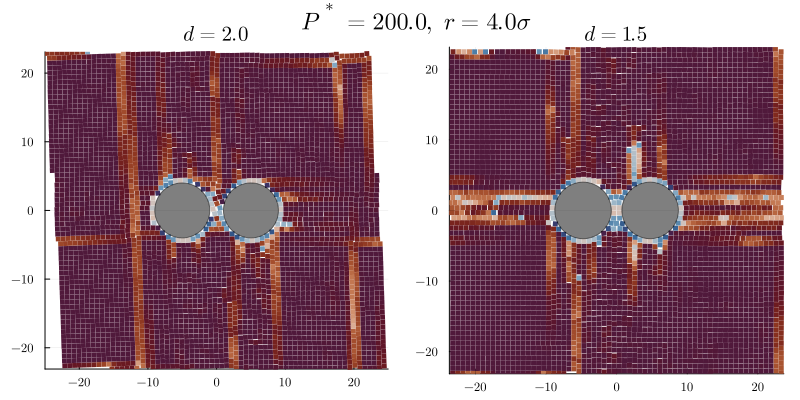

In [15]:
p1 = plotdoubledisk(4.0, 2.0, 200.0)
plot!(p1, title="\$d=2.0\$")
p2 = plotdoubledisk(4.0, 1.5, 200.0)
plot!(p2, title="\$d=1.5\$")

p = plot(p1, p2, layout=(1, 2), plot_title="\$P^*=200.0,\\ r=4.0\\sigma\$", size=(800, 400))
savefig(p, "../fig/doubledisk_200.0p_2.0d_1.5d.pdf")
display(p)

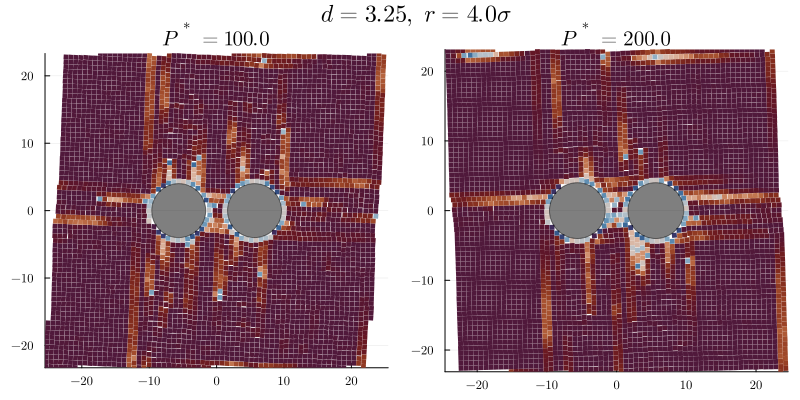

In [17]:
p1 = plotdoubledisk(4.0, 3.25, 100.0)
plot!(p1, title="\$P^*=100.0\$")
p2 = plotdoubledisk(4.0, 3.25, 200.0)
plot!(p2, title="\$P^*=200.0\$")

p = plot(p1, p2, layout=(1, 2), plot_title="\$d=3.25,\\ r=4.0\\sigma\$", size=(800, 400))
savefig(p, "../fig/doubledisk_100.0p_200.0p_3.25d.pdf")
display(p)